In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import statsmodels.api as sm

from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from sklearn.feature_extraction.text import TfidfVectorizer

In [2]:
beer_df = pd.read_csv("total_df.csv", index_col = 0)

C:\Users\gisel\Anaconda3\envs\deeplearning\lib\site-packages\numpy\lib\arraysetops.py:569: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [3]:
beer_df.head(2)

,URL,Beer name,Brewery,Style,Style_Ranked,ABV,Score,Score_Ranked,Avg Rating,Reviews,...,Date Review,Look_rating,Smell_rating,tasting_rating,feel_rating,overall_rating,Username_id,Date of Review,Beer + Brewery,Beer_id
0,https://www.beeradvocate.com/beer/profile/150/...,Stegmaier Brewhouse Bock,"Lion Brewery, Inc.",German Bock,39.0,6.6,84.0,0.0,3.76,49,...,"Sep 19, 2011",3.5,3.0,3.0,3.5,3.0,30162,2011-09-19,"Stegmaier Brewhouse Bock - Lion Brewery, Inc.",84627
1,https://www.beeradvocate.com/beer/profile/150/...,Stegmaier Brewhouse Bock,"Lion Brewery, Inc.",German Bock,39.0,6.6,84.0,0.0,3.76,49,...,"Jun 11, 2011",3.5,3.0,3.0,3.0,3.5,11051,2011-06-11,"Stegmaier Brewhouse Bock - Lion Brewery, Inc.",84627


In [4]:
beer_df.columns

Index(['URL', 'Beer name', 'Brewery', 'Style', 'Style_Ranked', 'ABV', 'Score',
       'Score_Ranked', 'Avg Rating', 'Reviews', 'N_Ratings', 'Brewery_Name',
       'Brewery_City', 'Brewery_Country', 'Availability', 'N_Wants', 'N_Gots',
       'User Score', 'User_ratings', 'User comment', 'Username', 'Date Review',
       'Look_rating', 'Smell_rating', 'tasting_rating', 'feel_rating',
       'overall_rating', 'Username_id', 'Date of Review', 'Beer + Brewery',
       'Beer_id'],
      dtype='object')

### DATA ANALYSIS

In [5]:
import plotly.express as px
counts = beer_df["Brewery_Country"].value_counts()
counts.to_frame()
counts = counts.reset_index()
counts.columns = ["Country", "Number of Reviews"]


In [6]:
# The country with the most reviews is USA, followed by Canada and Belgium. 

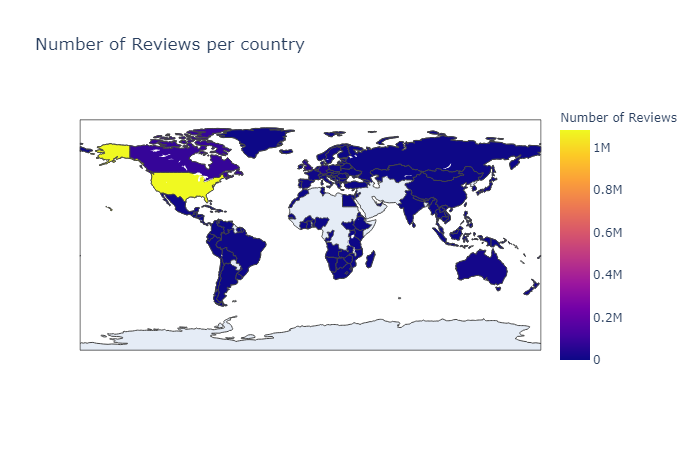

In [38]:
fig = px.choropleth(counts, locations='Country', locationmode='country names', color='Number of Reviews',title='Number of Reviews per country')
fig.show("png")

In [8]:
dates = beer_df["Date of Review"].value_counts()
dates.to_frame()
dates = dates.reset_index()
dates.columns = ["Date", "Number of Reviews"]
dates['year'] = pd.DatetimeIndex(dates['Date']).year
dates = dates.groupby("year").sum()
dates = dates.reset_index()
dates.columns = ["year", "Number of Reviews"]

In [9]:
style_avg_score = beer_df.groupby("Style").mean()
style_avg_score = style_avg_score.reset_index()
style_avg_score = style_avg_score.sort_values(by = "User Score", ascending = True)


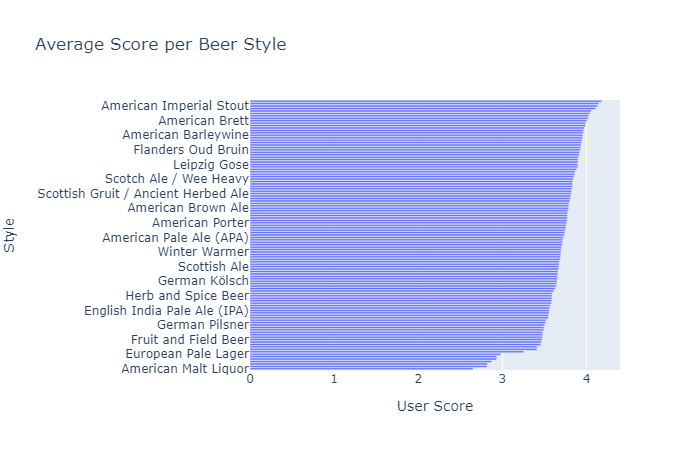

In [39]:
fig = px.bar(style_avg_score, x='User Score', y='Style', orientation = "h",title='Average Score per Beer Style')
fig.show("png")


In [11]:
# We can see above that the top rated beers are New England IPA, Belgian Lambic and American Imperial Stout
# On the other hand, we can see the least rated ones are American Lagers and low alchool beers

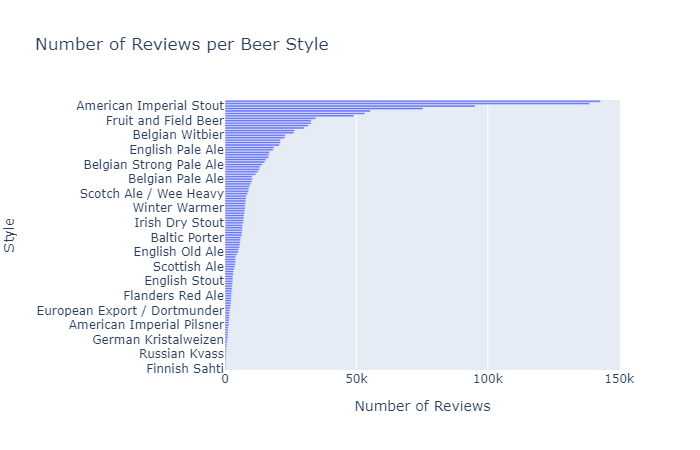

In [40]:
style_count = beer_df.groupby("Style").count()
style_count = style_count.reset_index()
style_count = style_count.sort_values(by = "URL", ascending = True)
fig = px.bar(style_count, x='URL', y='Style', orientation = "h", title='Number of Reviews per Beer Style', labels = {"URL" : "Number of Reviews"} )
fig.show("png")

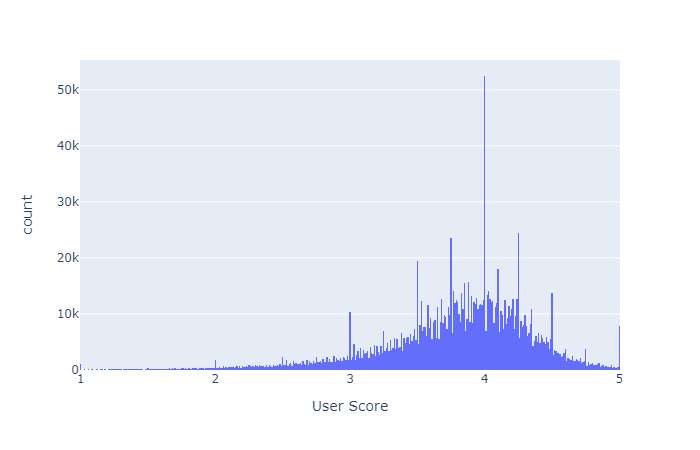

In [41]:
fig = px.histogram(beer_df, x="User Score")
fig.show("png")

### MODEL TO PREDICT A GOOD OR BAD RATING

 -  Can we predict if a user will give a good or a bad score for a given beer? Let's fit a logistic regression and Decision Tree to check

In [14]:
df_total = beer_df.copy()

In [15]:
df_total.loc[(df_total["User Score"] < 4), "User Score" ] = 0 
df_total.loc[(df_total["User Score"] >= 4), "User Score" ] = 1 

In [16]:
df_total.columns

Index(['URL', 'Beer name', 'Brewery', 'Style', 'Style_Ranked', 'ABV', 'Score',
       'Score_Ranked', 'Avg Rating', 'Reviews', 'N_Ratings', 'Brewery_Name',
       'Brewery_City', 'Brewery_Country', 'Availability', 'N_Wants', 'N_Gots',
       'User Score', 'User_ratings', 'User comment', 'Username', 'Date Review',
       'Look_rating', 'Smell_rating', 'tasting_rating', 'feel_rating',
       'overall_rating', 'Username_id', 'Date of Review', 'Beer + Brewery',
       'Beer_id'],
      dtype='object')

In [17]:
df_regression  = df_total[['Username_id','Beer_id','User Score','Availability','Style','ABV','Brewery_Name','Brewery_Country']].copy()

In [18]:
df_dummies = pd.get_dummies(df_regression[['Availability','Style','Brewery_Country']], drop_first = True)
df_dummies.shape

(1448216, 275)

In [19]:
df = pd.concat([df_regression, df_dummies], axis=1)
df.shape

(1448216, 283)

In [20]:
df_regression.shape

(1448216, 8)

In [21]:
target = df["User Score"].copy()

In [22]:
df.drop("User Score", axis = 1, inplace  = True)

In [23]:
df["User_score"] = target

In [24]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier

In [25]:
col_drop = ["Availability","Style","Brewery_Name","Brewery_Country"]

for col in df:
    if col in col_drop:
        df.drop(col, inplace = True, axis = 1)
        

In [26]:
df.shape

(1448216, 279)

In [27]:
# Splitting the data
X = df.iloc[:,0:278]
y = df.iloc[:,-1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)


In [28]:
LR_model = LogisticRegression()
LR_model.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [29]:
print(f"LR training set accuracy: {LR_model.score(X_train, y_train)}")

LR training set accuracy: 0.5931278982708772


In [30]:
coef_dict = {}
for coef, feat in zip(LR_model.coef_[0,:],X_train.columns):
    coef_dict[feat] = coef

In [31]:
coefficients = pd.DataFrame.from_dict(coef_dict,orient='index')
coefficents = coefficients.reset_index()
coefficents.columns = ["Feature", "Coefficient"]
coefficents.sort_values(by = "Coefficient", ascending = False)

,Feature,Coefficient
2,ABV,1.345249e-08
4,Availability_Rotating,2.754856e-09
269,Brewery_Country_United States,1.216626e-09
25,Style_American Imperial Stout,9.288412e-10
21,Style_American Imperial IPA,7.695556e-10
...,...,...
29,Style_American Pale Ale (APA),-2.667766e-10
143,Brewery_Country_Canada,-4.093024e-10
9,Availability_Year-round,-3.173470e-09
1,Beer_id,-2.637146e-06


 - DT model

In [32]:
DT_model = DecisionTreeClassifier(max_depth=3)
DT_model.fit(X_train, y_train)


print(f"DT training set accuracy: {DT_model.score(X_train, y_train)}")

DT training set accuracy: 0.6685586500037978


In [33]:
DT_model.score(X_test,y_test)

0.668562484895216

In [34]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

C:\Users\gisel\Anaconda3\envs\deeplearning\lib\site-packages\sklearn\externals\six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).



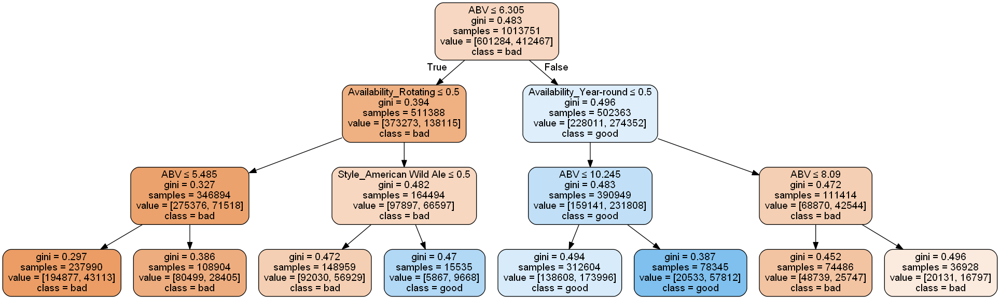

In [35]:
import sklearn.tree as tree
import pydotplus
from sklearn.externals.six import StringIO 
from IPython.display import Image
dic = {0: "bad", 1 : "good"}

dot_data = StringIO()
tree.export_graphviz(DT_model, 
 out_file=dot_data, 
 class_names=dic,
feature_names = list(X.columns),                     
 filled=True, 
 rounded=True, 
 special_characters=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue()) 
Image(graph.create_png())

### REVIEWS PER STYLE 

In [36]:
reviews = beer_df[['Beer + Brewery','Beer name', 'Brewery', 'Style',"User comment"]].copy()

##### As we can see below, different styles of beers have different top words.  
 - For example, for American Pale Ale aftertaste is not a top word, as it is for Belgian Pale Ale. 
 - Belgian Gauze seems to be an acidic beer
 - New England IPA has aroma as a top word
 - American Blonde Ale has a few negative words such as bad and drinkable 

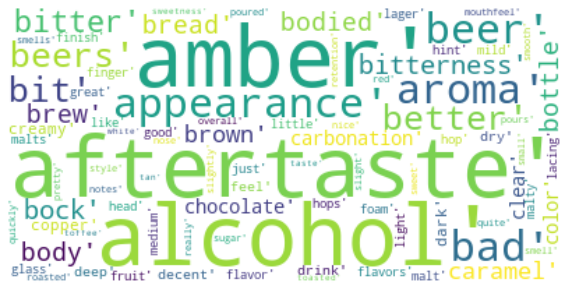

German Bock


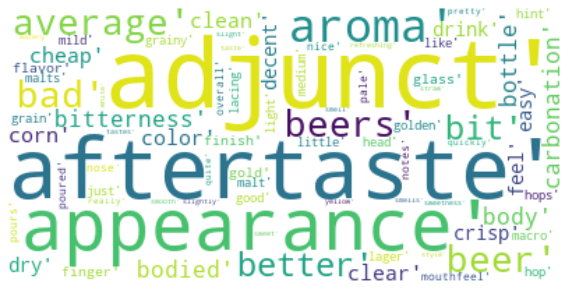

American Adjunct Lager


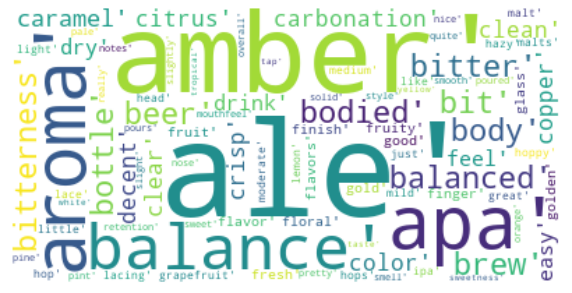

American Pale Ale (APA)


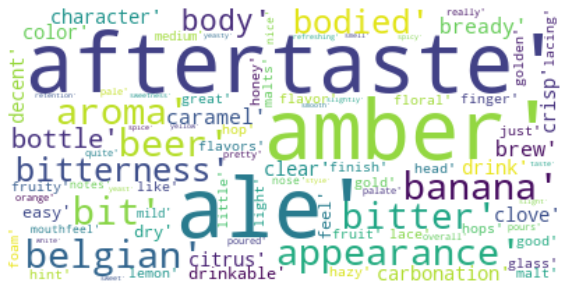

Belgian Pale Ale


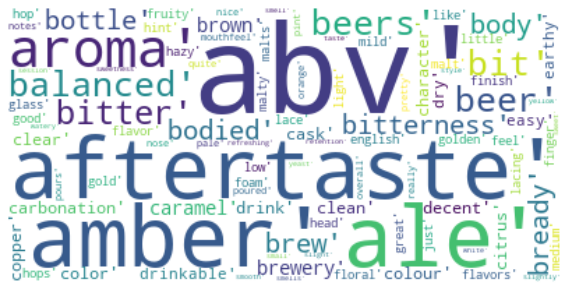

English Pale Mild Ale


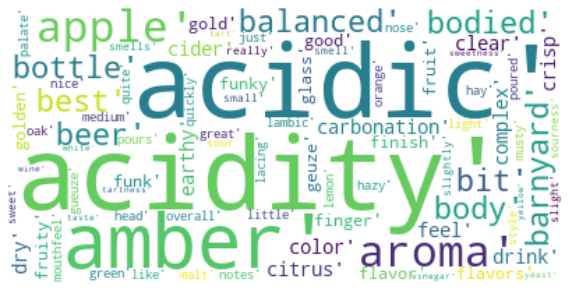

Belgian Gueuze


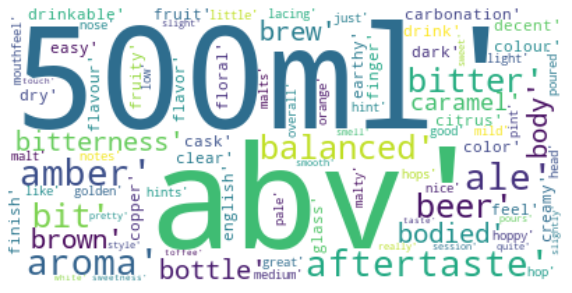

English Bitter


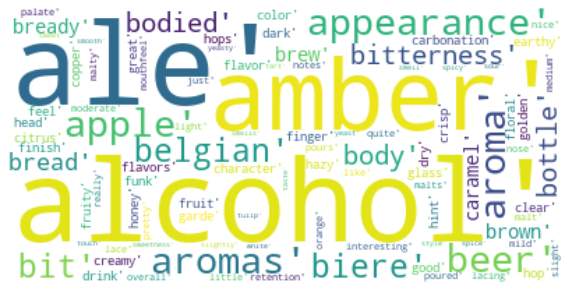

French Bière de Garde


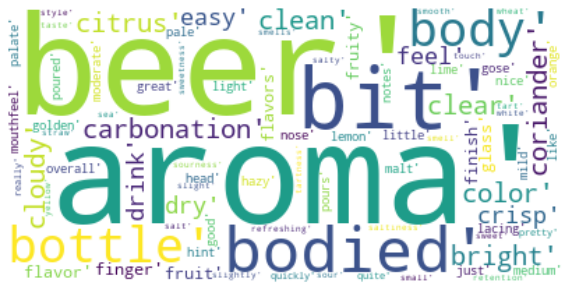

Leipzig Gose


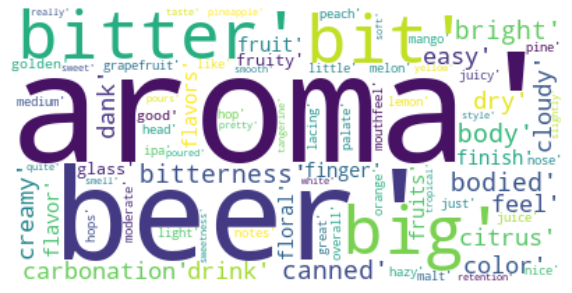

New England IPA


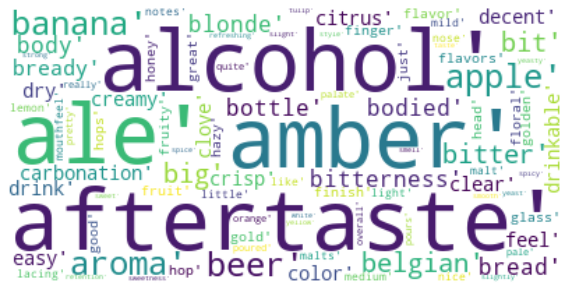

Belgian Blonde Ale 


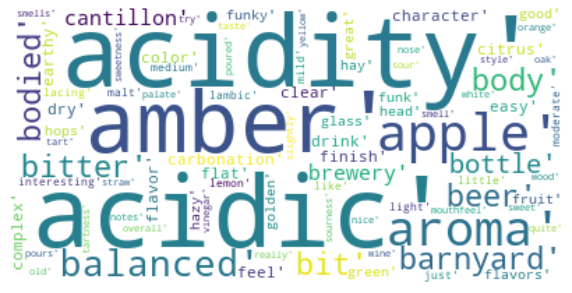

Belgian Lambic


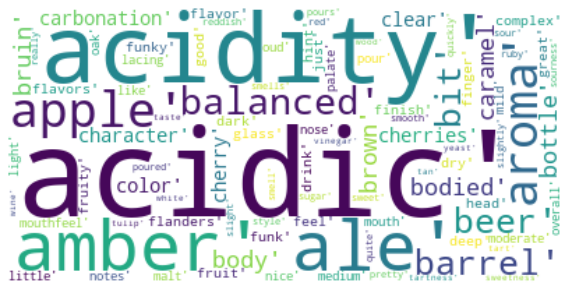

Flanders Oud Bruin


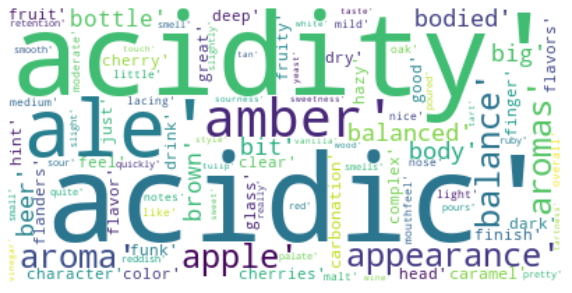

Flanders Red Ale


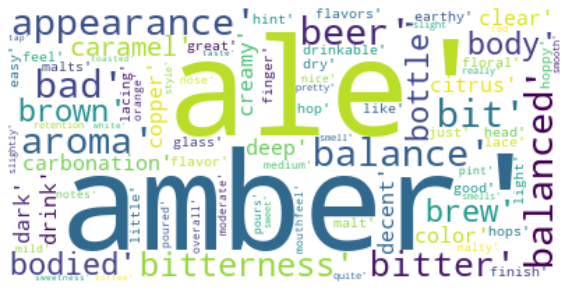

American Amber / Red Ale


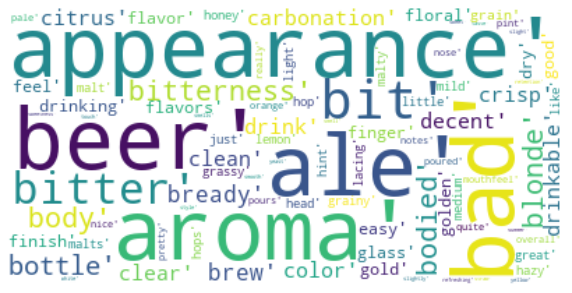

American Blonde Ale


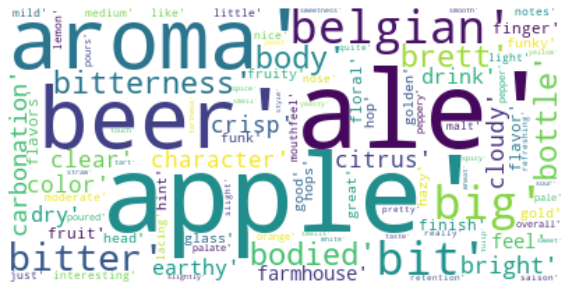

Belgian Saison


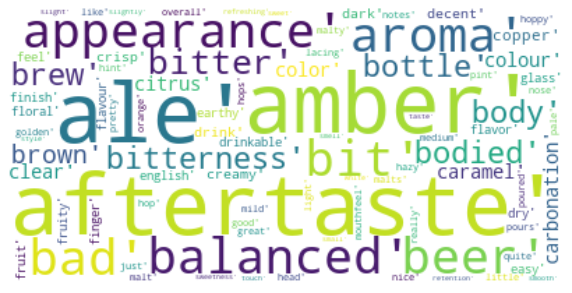

English Pale Ale


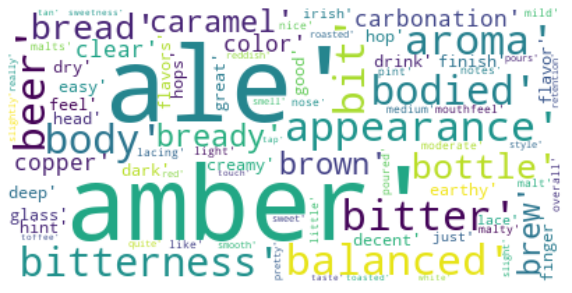

Irish Red Ale


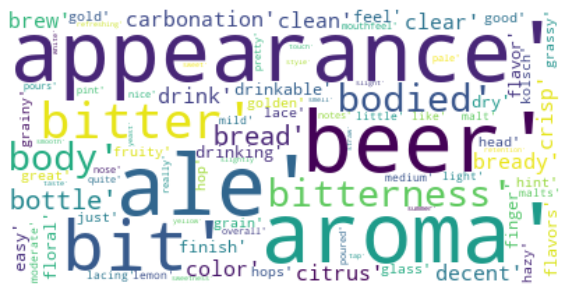

German Kölsch


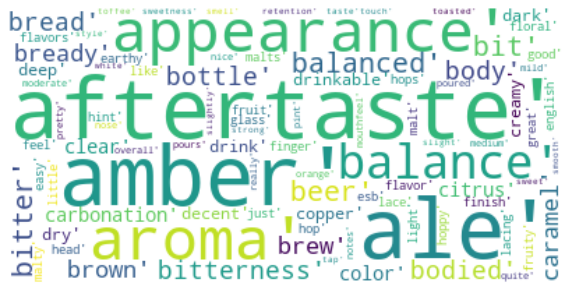

English Extra Special / Strong Bitter (ESB)


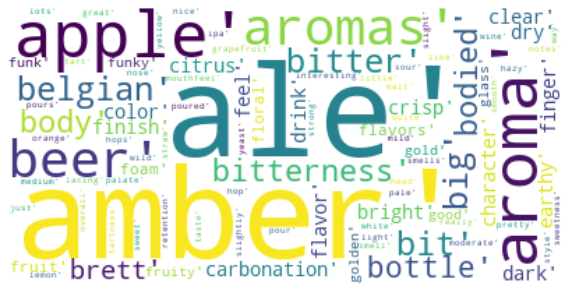

American Brett


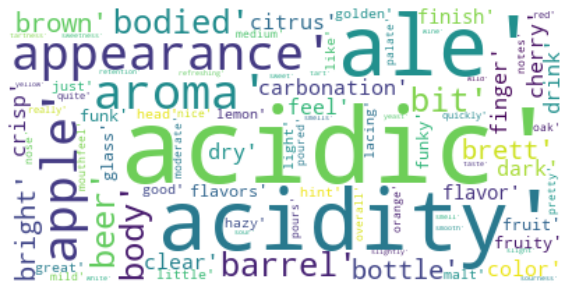

American Wild Ale


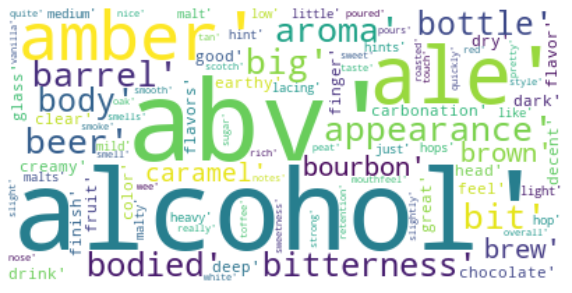

Scotch Ale / Wee Heavy


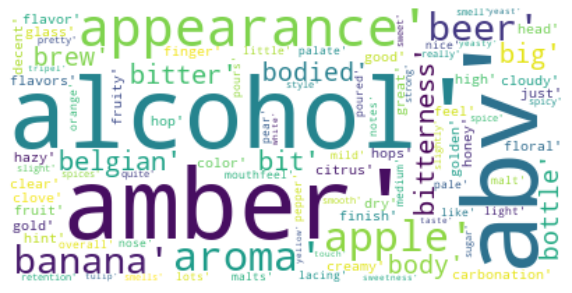

Belgian Tripel


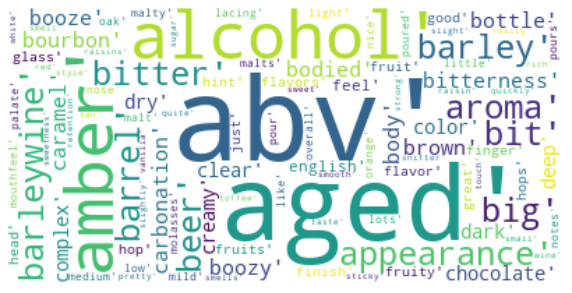

English Barleywine


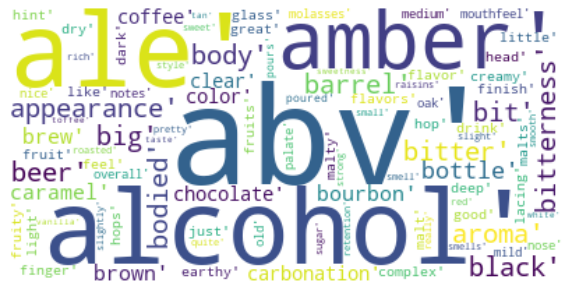

English Old Ale


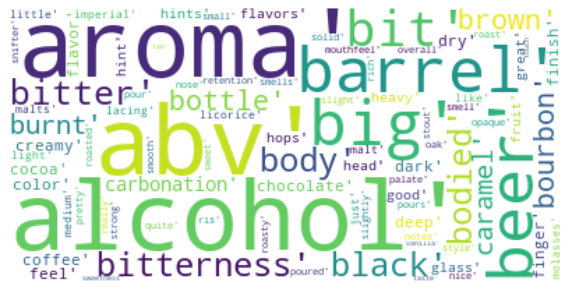

Russian Imperial Stout


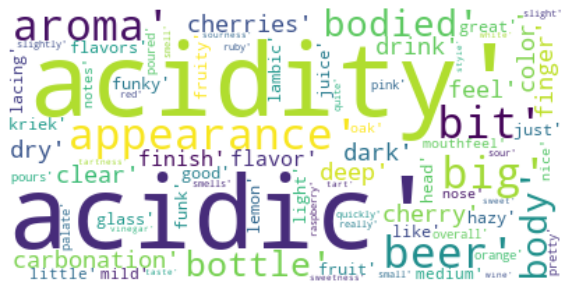

Belgian Fruit Lambic


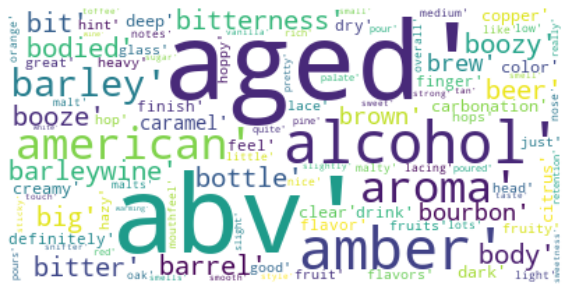

American Barleywine


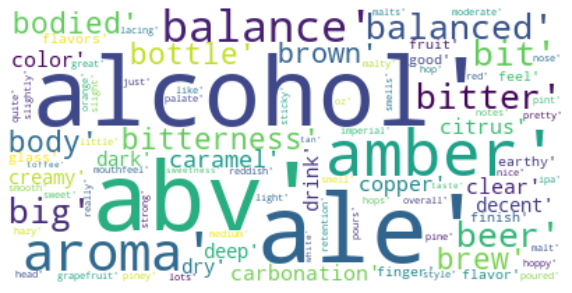

American Imperial Red Ale


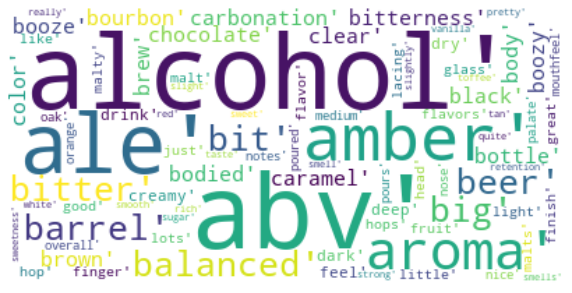

American Strong Ale


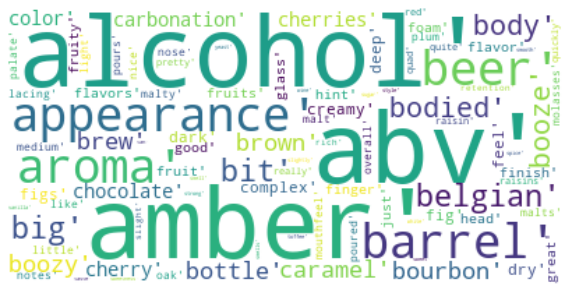

Belgian Quadrupel (Quad)


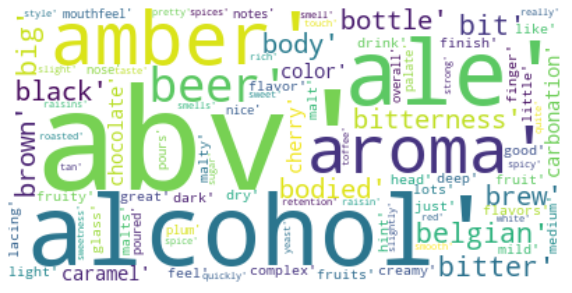

Belgian Strong Dark Ale


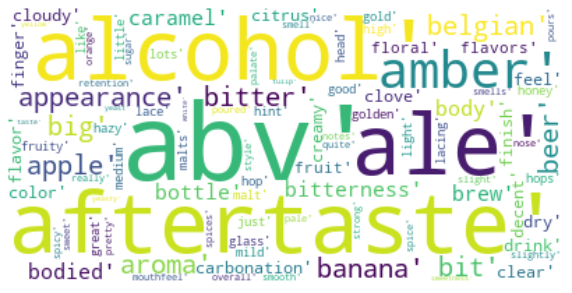

Belgian Strong Pale Ale


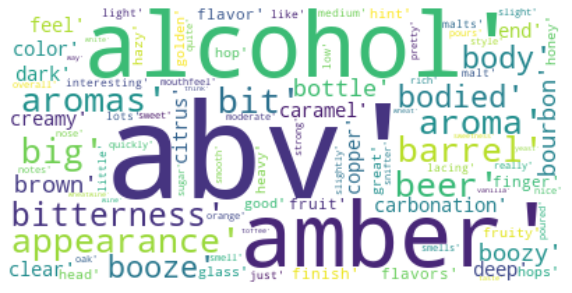

American Wheatwine Ale


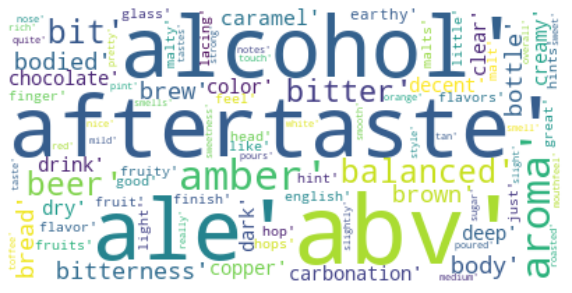

English Strong Ale


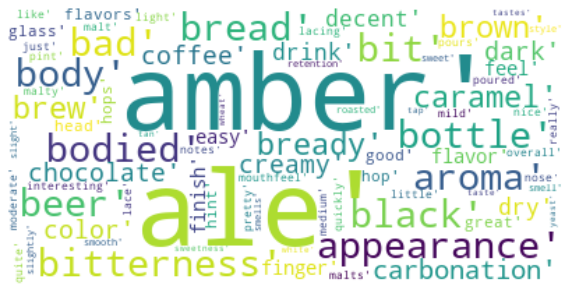

American Dark Wheat Ale


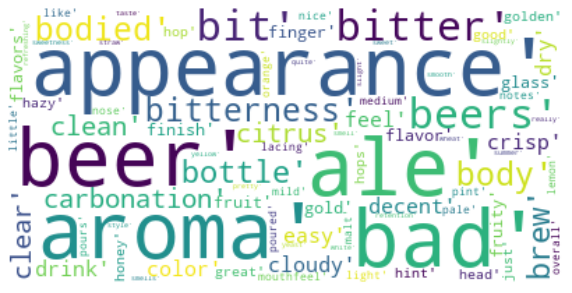

American Pale Wheat Ale


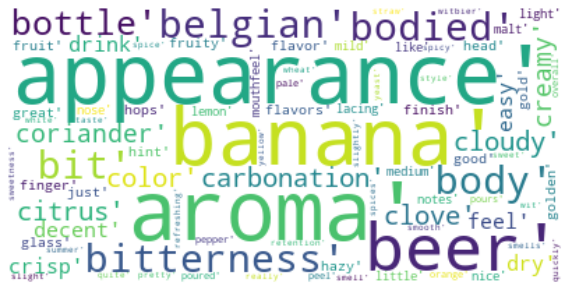

Belgian Witbier


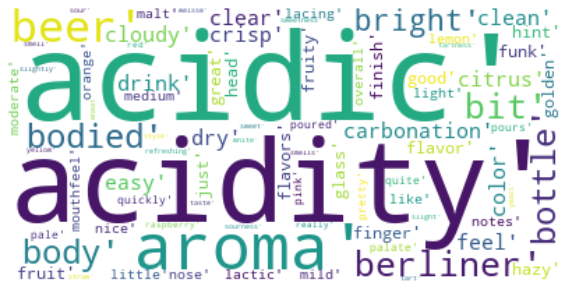

Berliner Weisse


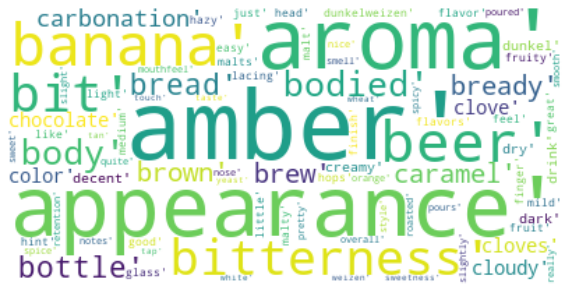

German Dunkelweizen


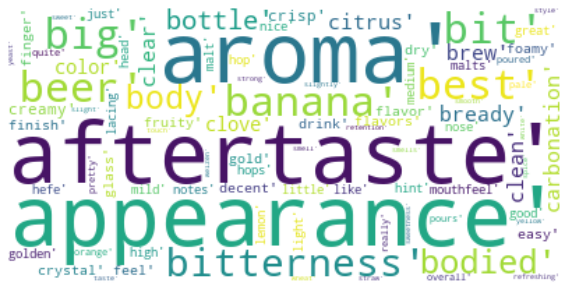

German Kristalweizen


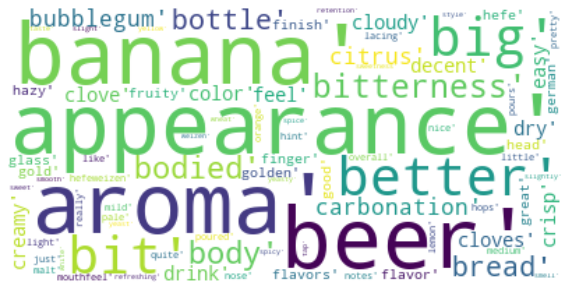

German Hefeweizen


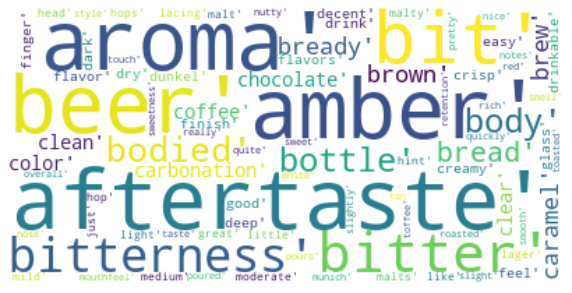

Munich Dunkel Lager


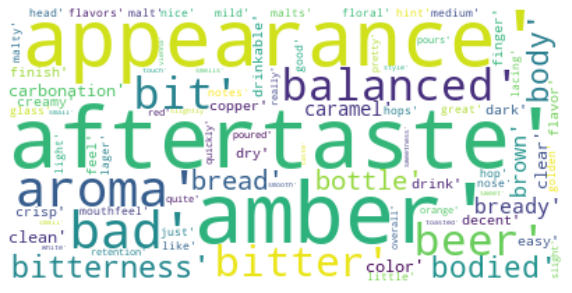

Vienna Lager


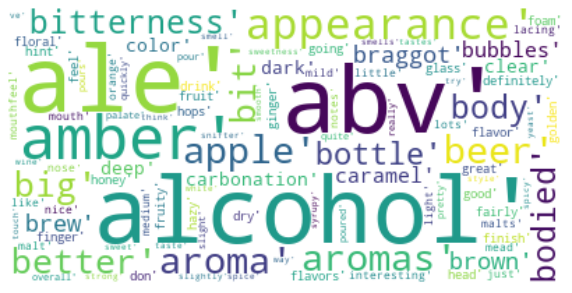

Braggot


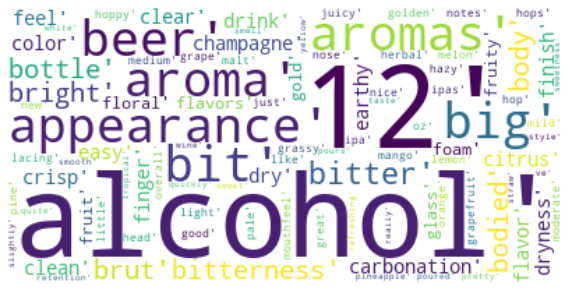

American Brut IPA


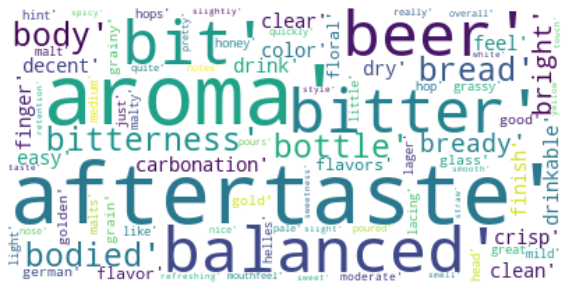

German Helles


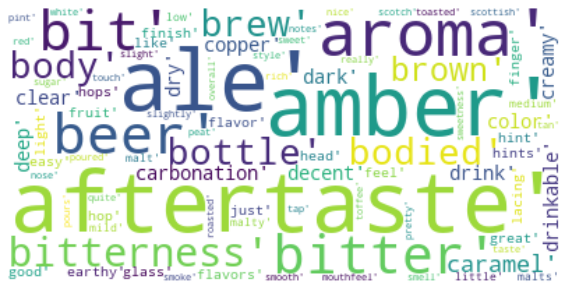

Scottish Ale


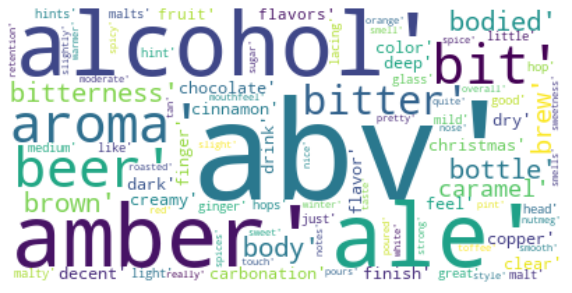

Winter Warmer


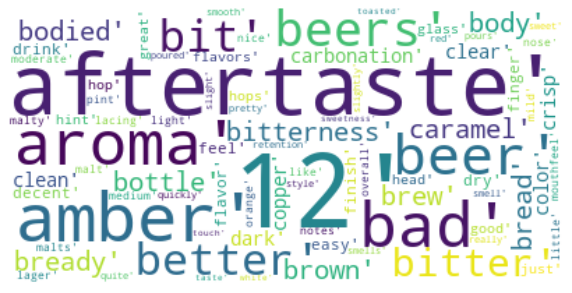

American Amber / Red Lager


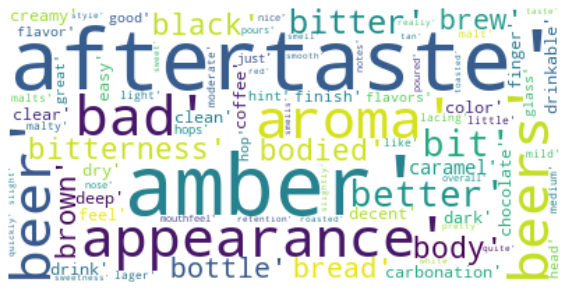

European Dark Lager


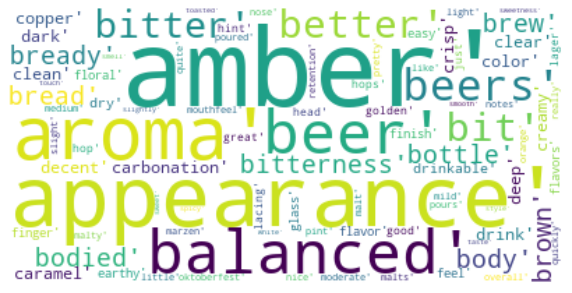

German Märzen / Oktoberfest


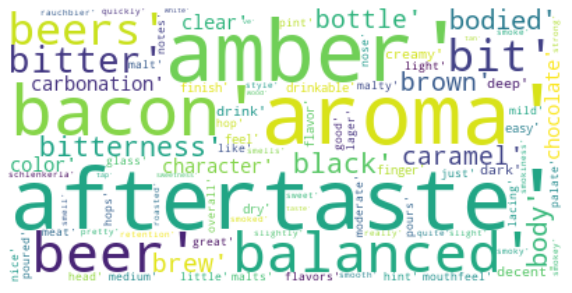

German Rauchbier


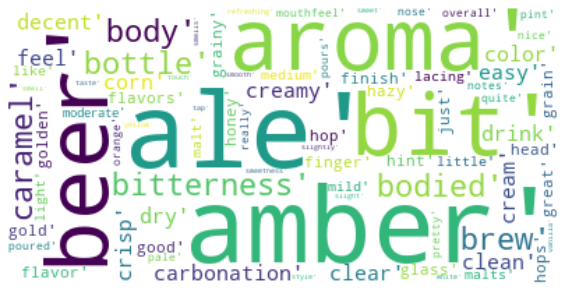

American Cream Ale


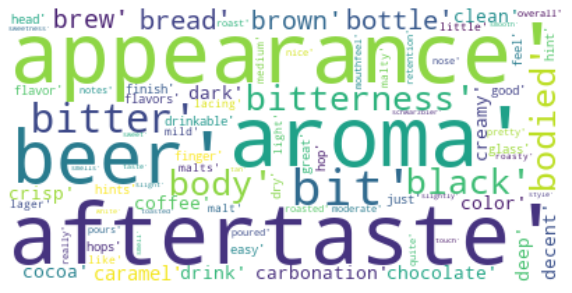

German Schwarzbier


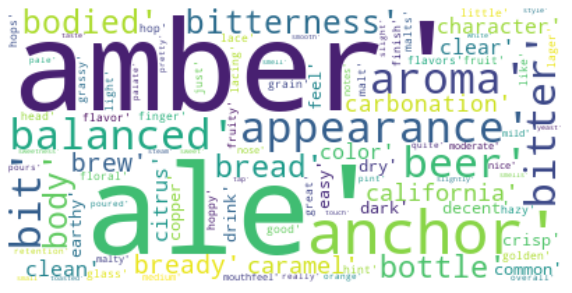

California Common / Steam Beer


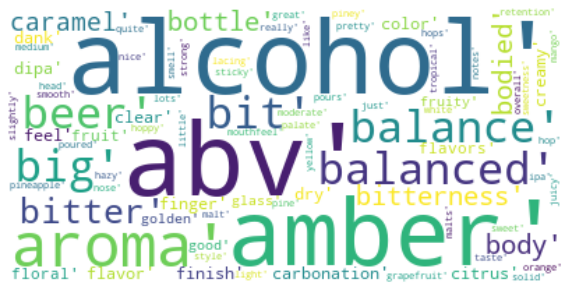

American Imperial IPA


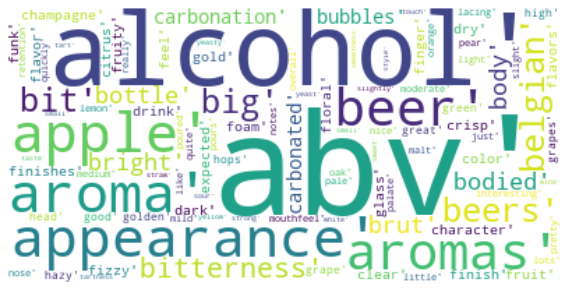

Bière de Champagne / Bière Brut


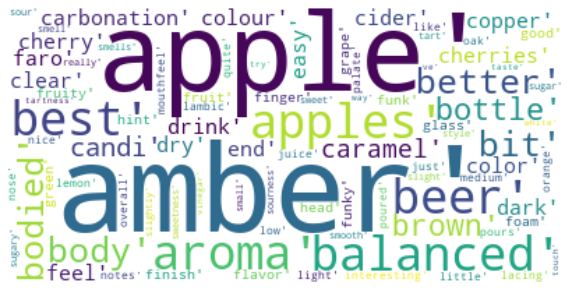

Belgian Faro


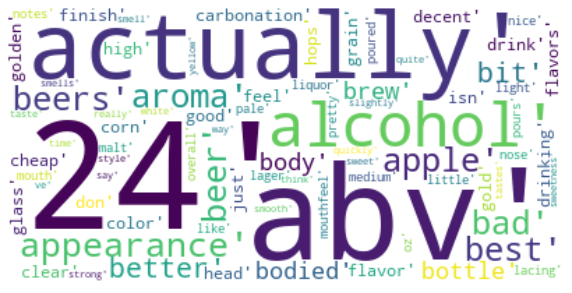

American Malt Liquor


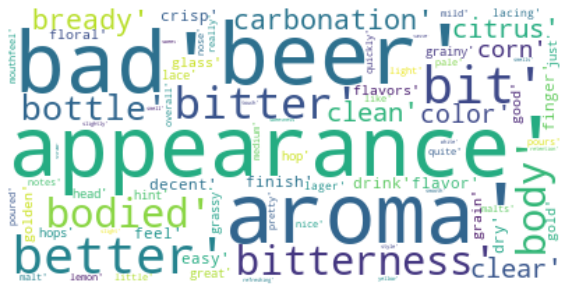

American Lager


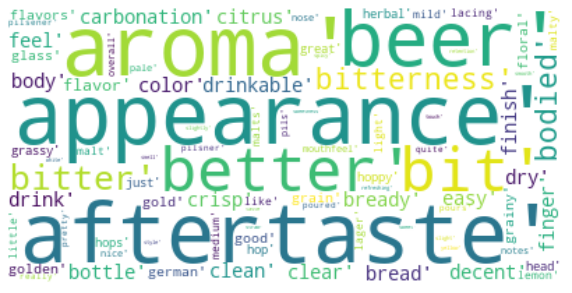

German Pilsner


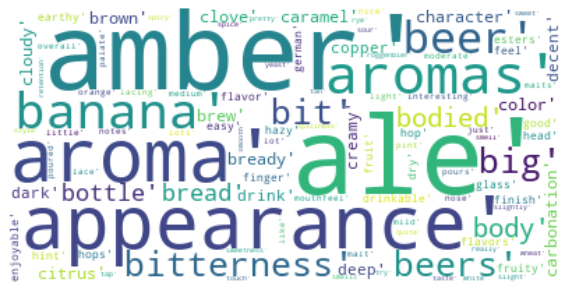

German Roggenbier


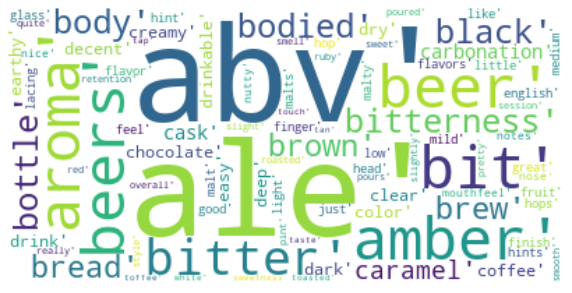

English Dark Mild Ale


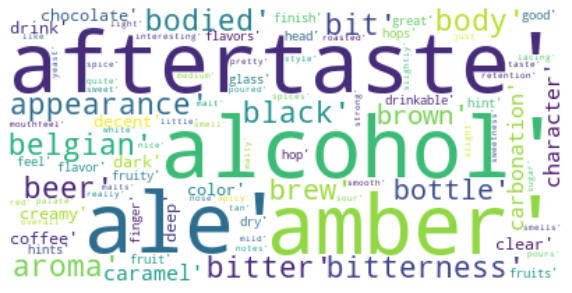

Belgian Dark Ale


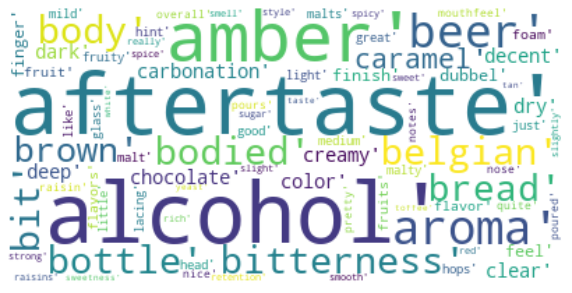

Belgian Dubbel


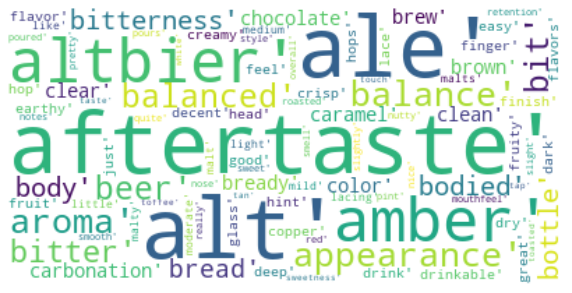

German Altbier


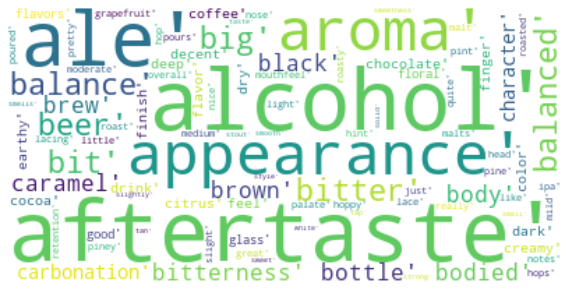

American Black Ale


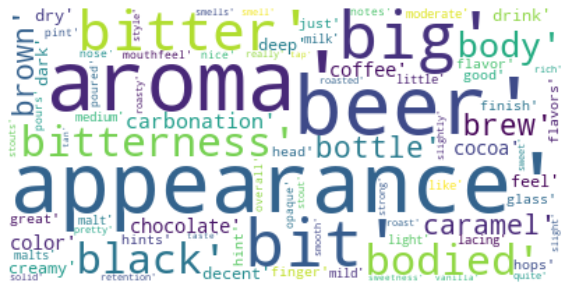

American Stout


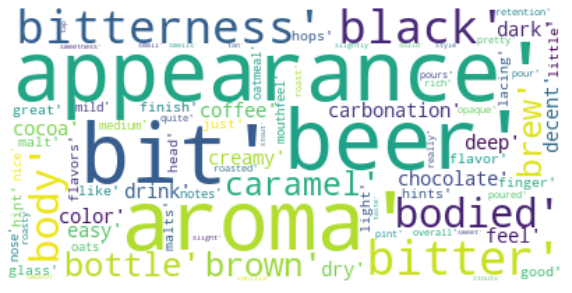

English Oatmeal Stout


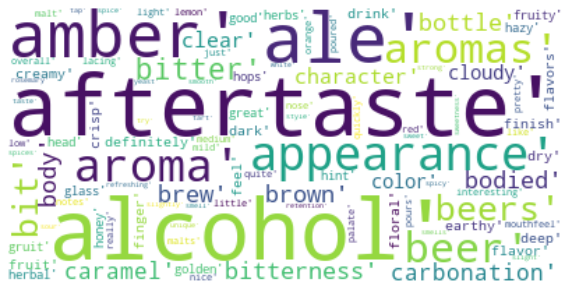

Scottish Gruit / Ancient Herbed Ale


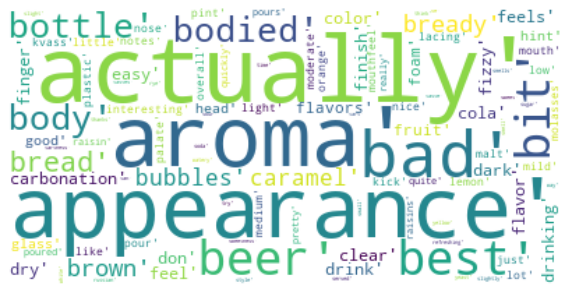

Russian Kvass


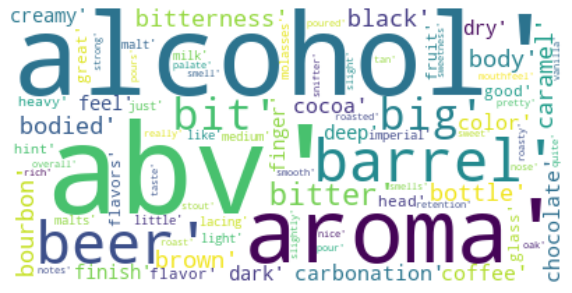

American Imperial Stout


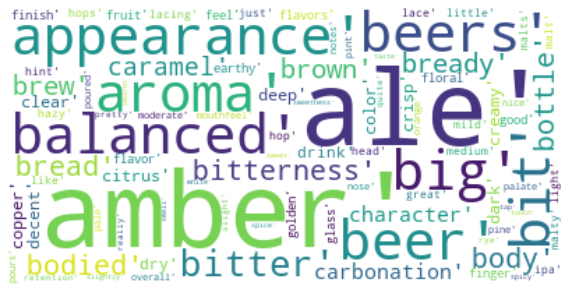

Rye Beer


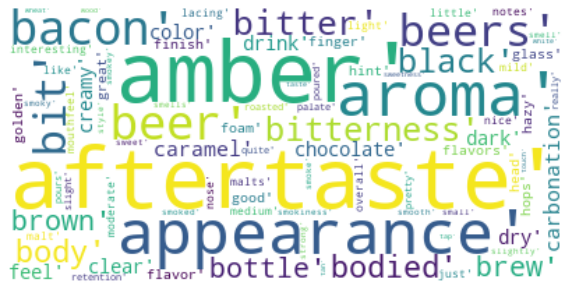

Smoke Beer


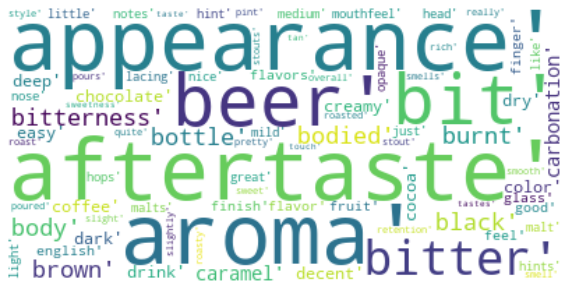

English Stout


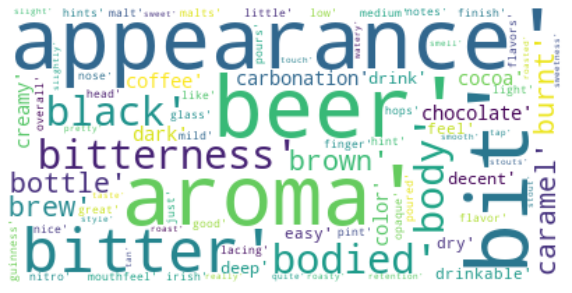

Irish Dry Stout


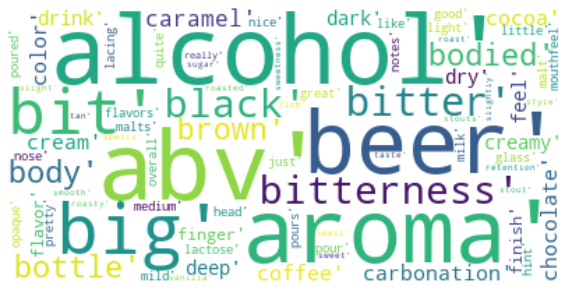

English Sweet / Milk Stout


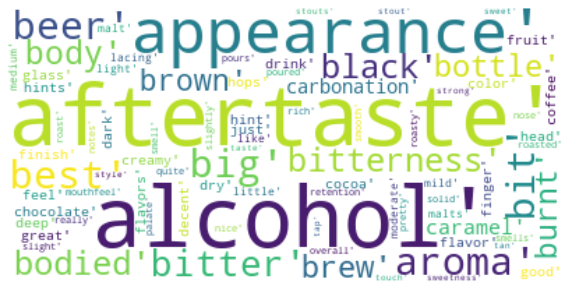

Foreign / Export Stout


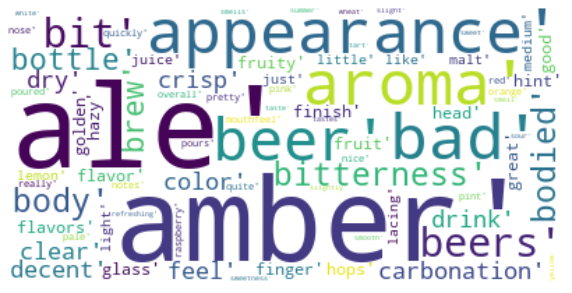

Fruit and Field Beer


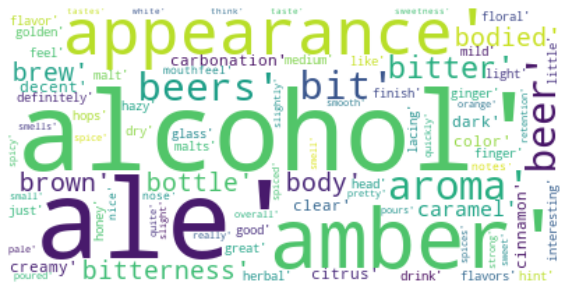

Herb and Spice Beer


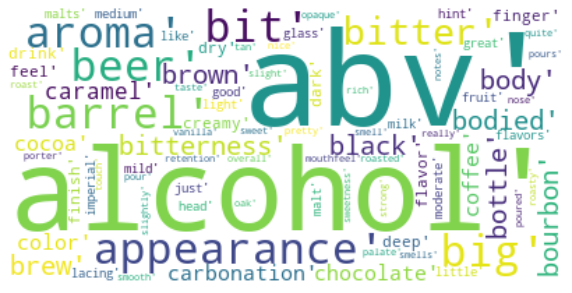

American Imperial Porter


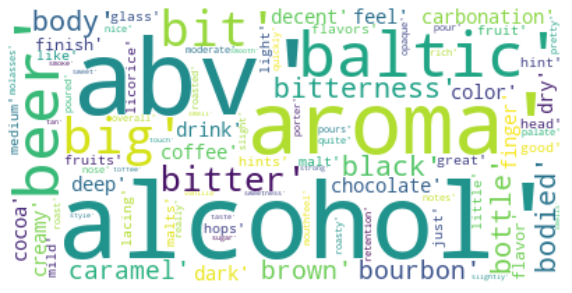

Baltic Porter


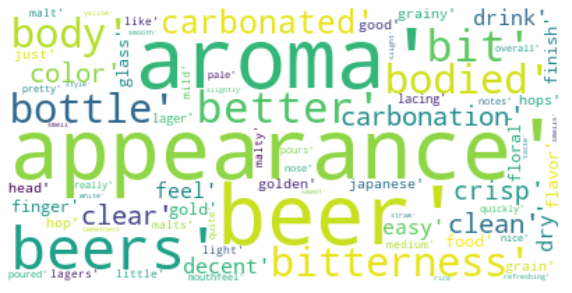

Japanese Rice Lager


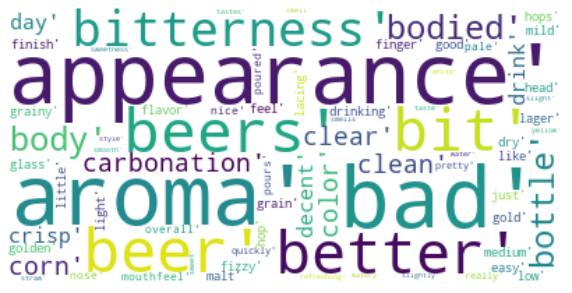

American Light Lager


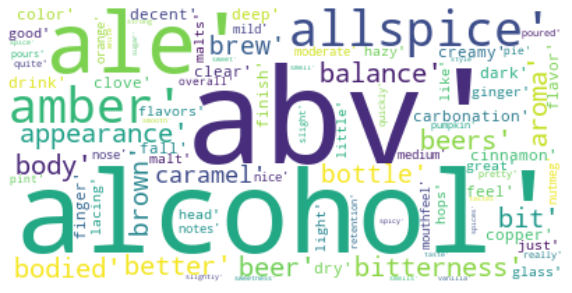

Pumpkin Beer


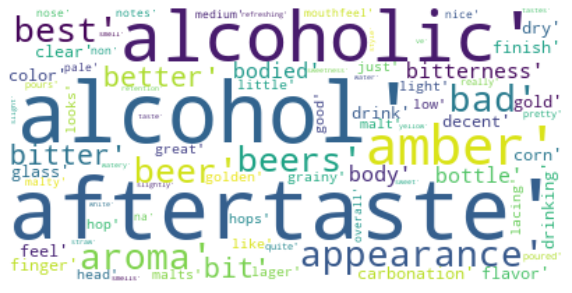

Low Alcohol Beer


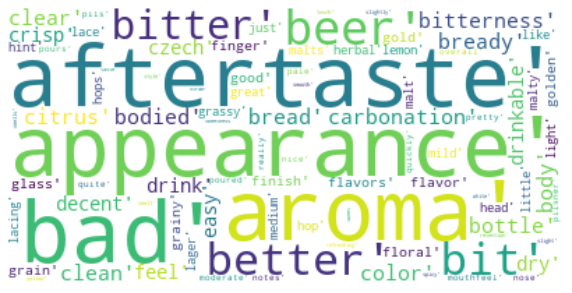

Bohemian Pilsener


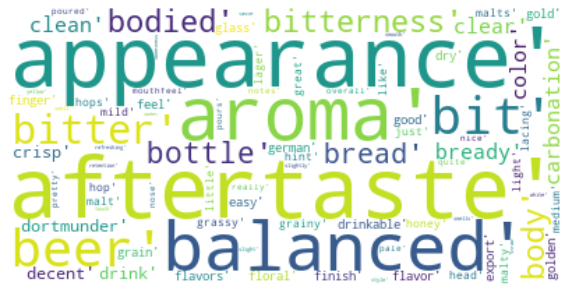

European Export / Dortmunder


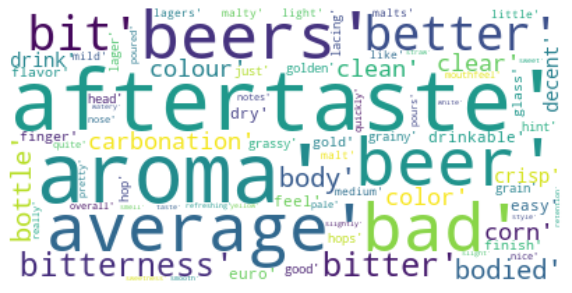

European Pale Lager


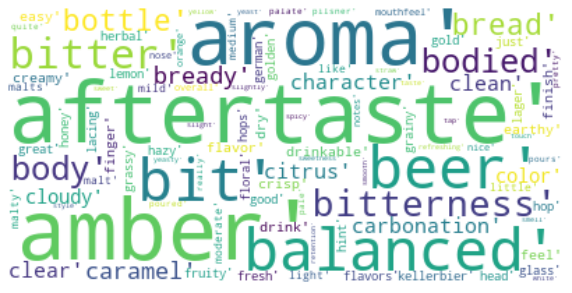

German Kellerbier / Zwickelbier


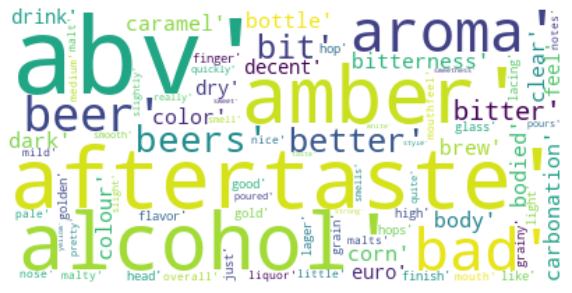

European Strong Lager


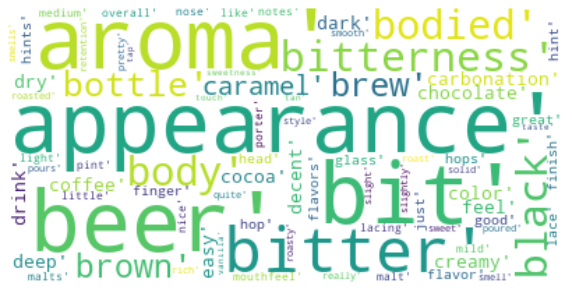

American Porter


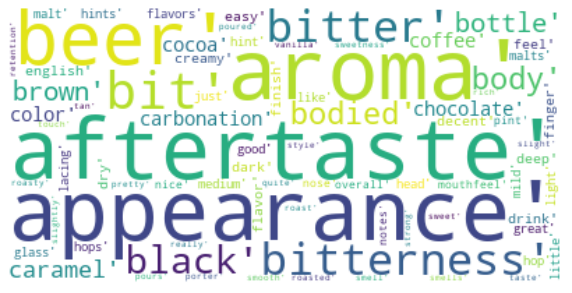

English Porter


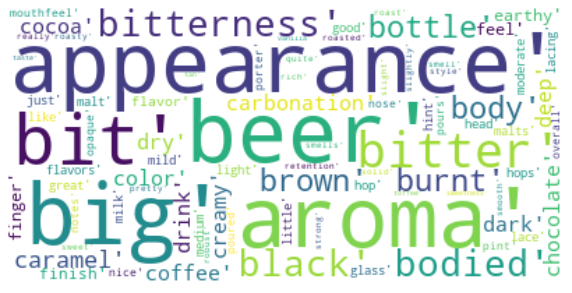

Robust Porter 


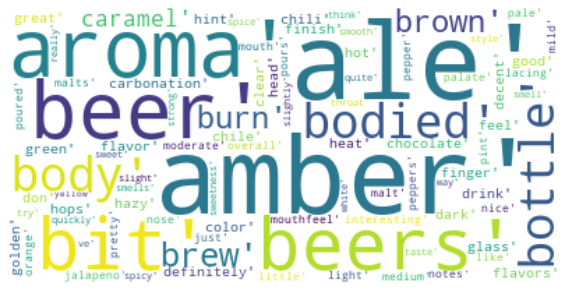

Chile Beer


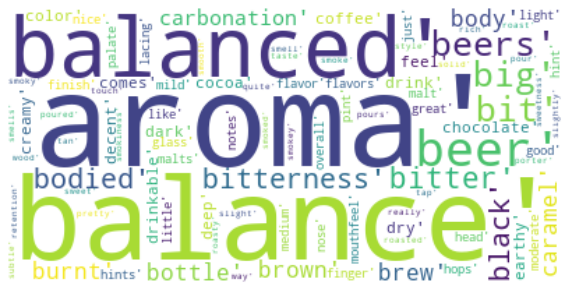

Smoke Porter


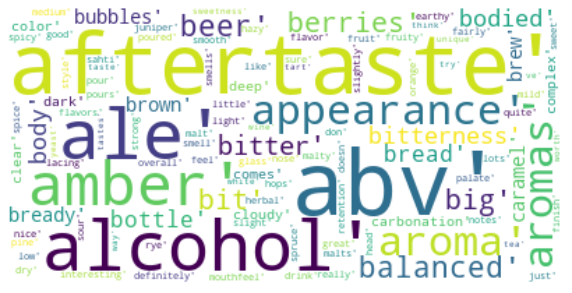

Finnish Sahti


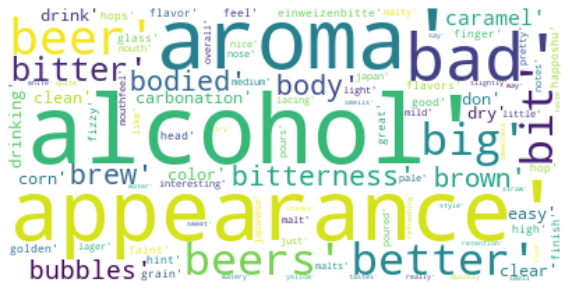

Japanese Happoshu


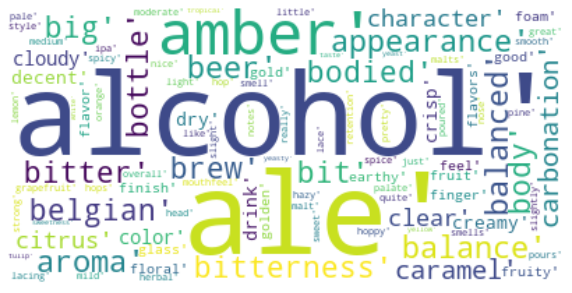

Belgian IPA


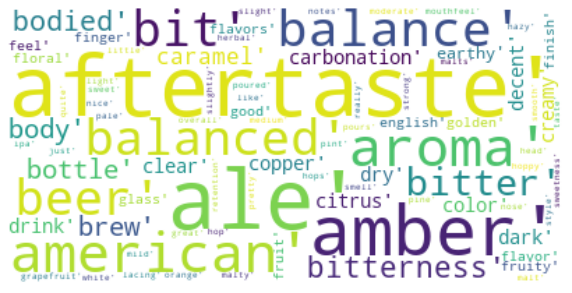

English India Pale Ale (IPA)


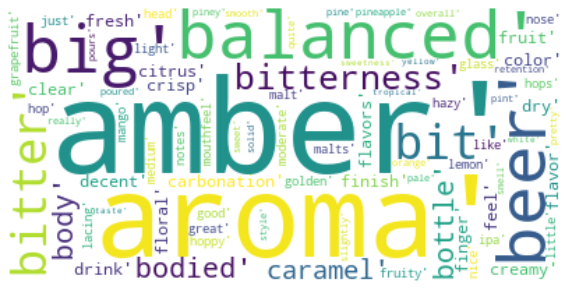

American IPA


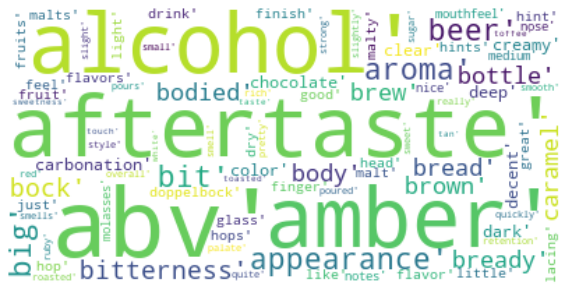

German Doppelbock


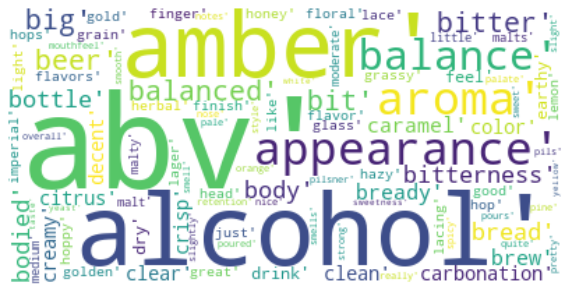

American Imperial Pilsner


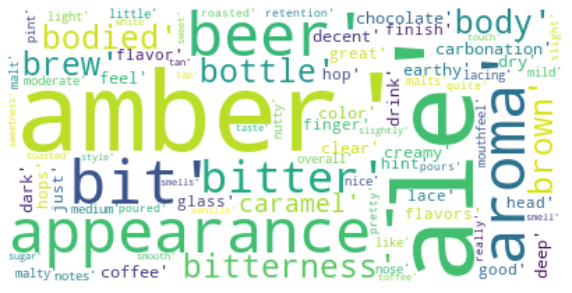

American Brown Ale


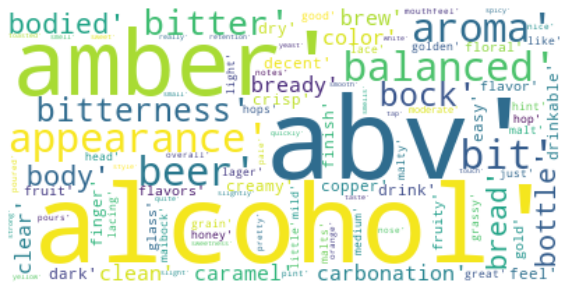

German Maibock


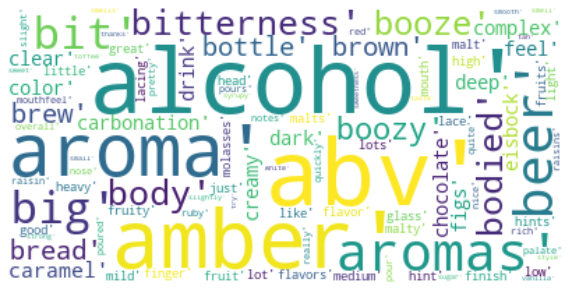

German Eisbock


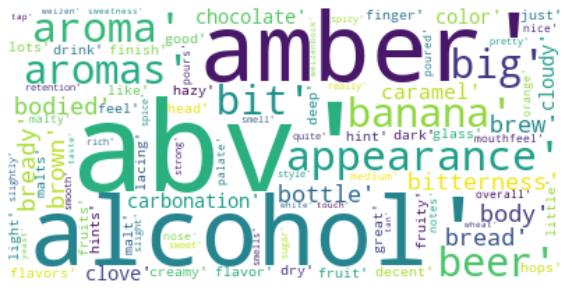

German Weizenbock


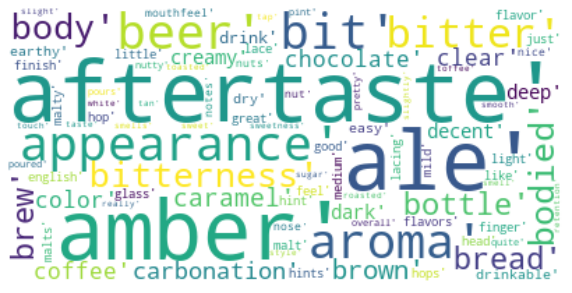

English Brown Ale


In [37]:
for style in reviews["Style"].unique():
    new_data = reviews[reviews["Style"] == style]
    beer_review = new_data["User comment"]
    tfidf = TfidfVectorizer(min_df= 0.1,stop_words="english").fit(beer_review)
    data = tfidf.transform(beer_review)
    my_df = pd.DataFrame(columns=tfidf.get_feature_names(), data=data.toarray()) 
    text = tfidf.get_feature_names()
    wordcloud = WordCloud(background_color="white").generate(str(text))
    plt.figure(figsize = (10.0,8.0))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()
    print(style)
    